### 커널 확인 및 라이브러리 설치

In [1]:
# 현재 가상환경 커널 디렉토리 파악
import sys
print(sys.version)
print(sys.executable)
print(sys.path)

3.10.8 (main, Nov 24 2022, 14:13:03) [GCC 11.2.0]
/home/dlawodud0484/anaconda3/envs/CNN/bin/python
['/home/dlawodud0484', '/home/dlawodud0484/anaconda3/envs/CNN/lib/python310.zip', '/home/dlawodud0484/anaconda3/envs/CNN/lib/python3.10', '/home/dlawodud0484/anaconda3/envs/CNN/lib/python3.10/lib-dynload', '', '/home/dlawodud0484/anaconda3/envs/CNN/lib/python3.10/site-packages']


In [ ]:
! {sys.executable} -m pip install scikit-image
! {sys.executable} -m pip install opencv-python

# 영상처리

https://076923.github.io/categories/

In [229]:
import cv2
import matplotlib.pyplot as plt

In [230]:
# 원본 이미지 불러오기
img = cv2.imread('/home/hyun425/Yolo/test_image/bee6.jpg', cv2.IMREAD_COLOR)
original_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

### Edge 실험

##### - sobel
##### - laplacian
##### - canny

In [49]:
gray = cv2.cvtColor(original_img, cv2.COLOR_RGB2GRAY)

In [50]:
# 인접한 픽셀들의 차이로 기울기 크기를 구함
# (이미지, 출력 이미지 정밀도, X방향 미분 차수, Y방향 미분 차수, 커널 크기, 비유르 오프셋, 테두리 외삼법)
# cv2.Sobel(src, ddepth, dx, dy, ksize, scale, delta, borderType)
sobel = cv2.Sobel(gray, cv2.CV_8U, 1, 0, 3)

# 2차 미분의 형태로 가장자리가 밝은 부분에서 발생했는지, 어두운 부분에서 발생했는지 구분
# cv2.laplacian(src, ddepth, ksize, scale, delta, borderType)
laplacian = cv2.Laplacian(gray, cv2.CV_8U, ksize=3)

#1차 미분 계산 후, 4방향으로 미분하여 극대값을 갖는 지점들이 가장자리가 됨
# 성능이 제일 좋고 노이즈에 민감하지 않음
# (이미지, 하위 임계값, 상위 임계값, 소벨 연산자 마스크 크기, L2기울기)
# cv2.Canny(src, threshold1, threshold2, apertureSize, L2gradient)
canny = cv2.Canny(img, 100, 255)

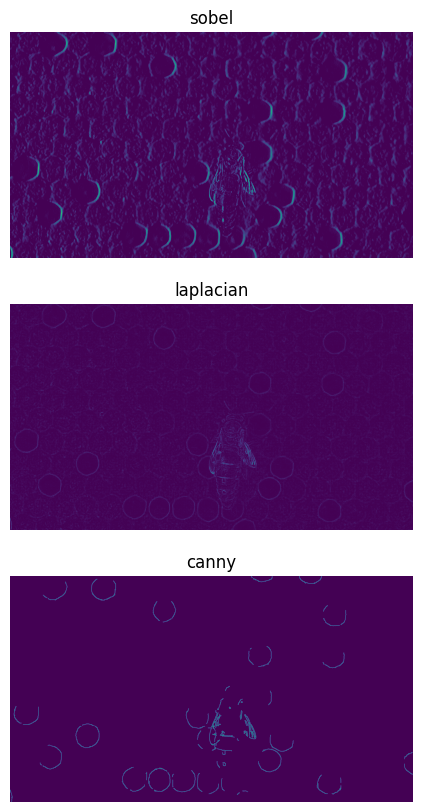

In [51]:
plt.figure(figsize=(10,10))

plt.subplot(3,1,1)
plt.imshow(sobel)
plt.axis('off')  # 축 제거
plt.title('sobel')

plt.subplot(3,1,2)
plt.imshow(laplacian)
plt.axis('off')  # 축 제거
plt.title('laplacian')

plt.subplot(3,1,3)
plt.imshow(canny)
plt.axis('off')  # 축 제거
plt.title('canny')

plt.show()

### 색상모드

##### - HSV
##### - GRAY

In [52]:
import numpy as np

In [53]:
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

In [54]:
# 검은색 빈 공간 이미지
# np.zeros((높이, 너비, 채널), dtype=정밀도)
height, width, channel = img.shape
zero = np.zeros((height,width,1))

In [55]:
# 채널 분리
h, s, v = cv2.split(hsv)


In [56]:
# 채널 병합
merge_img = cv2.merge((h,s,v))

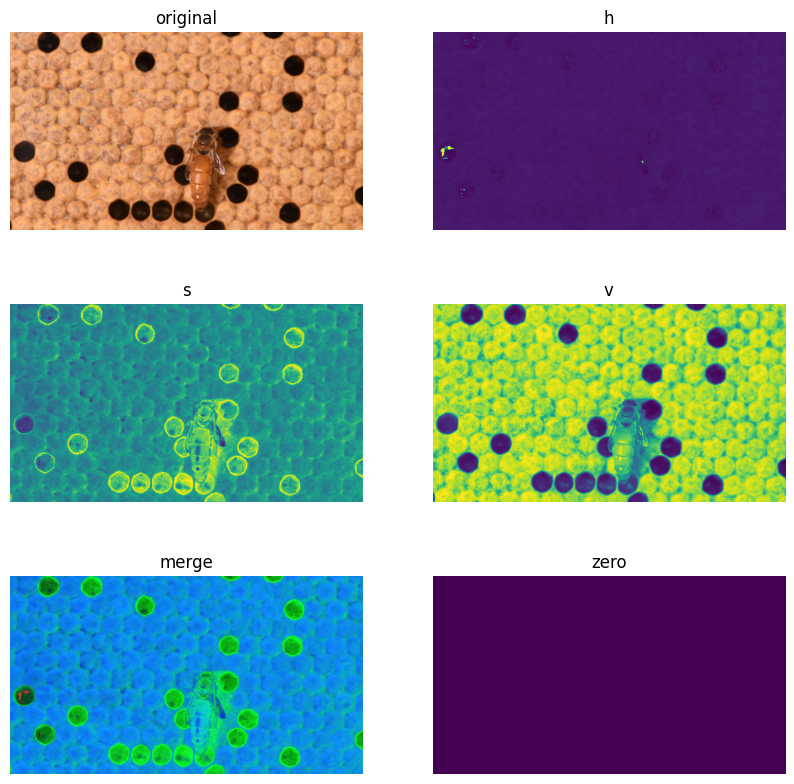

In [57]:
plt.figure(figsize=(10,10))

plt.subplot(3,2,1)
plt.imshow(original_img)
plt.axis('off')  # 축 제거
plt.title('original')

plt.subplot(3,2,2)
plt.imshow(h)
plt.axis('off')  # 축 제거
plt.title('h')

plt.subplot(3,2,3)
plt.imshow(s)
plt.axis('off')  # 축 제거
plt.title('s')

plt.subplot(3,2,4)
plt.imshow(v)
plt.axis('off')  # 축 제거
plt.title('v')

plt.subplot(3,2,5)
plt.imshow(merge_img)
plt.axis('off')
plt.title('merge')

plt.subplot(3,2,6)
plt.imshow(zero)
plt.axis('off')
plt.title('zero')

plt.show()

In [59]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

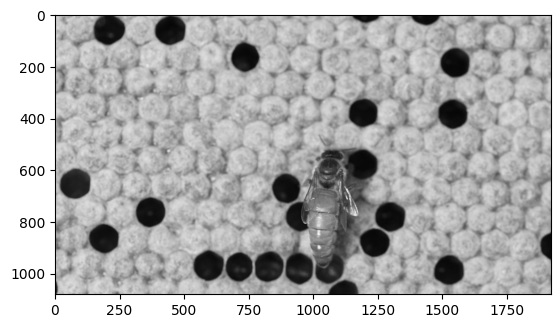

In [61]:
plt.imshow(gray,cmap='gray')
plt.axis('on')
plt.show()

### 이진화

##### - Binary

In [62]:
ret, dst = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY)
# (이미지, 임계값, 색상 최대값, 임계값 형식)

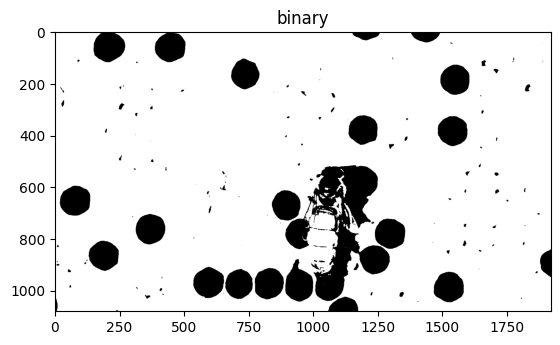

In [63]:
plt.imshow(dst, cmap='gray')
plt.title('binary')
plt.show()

### Heatmap

In [64]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [65]:
custom_effect = cv2.stylization(img, sigma_s=150, sigma_r=0.25)
custom_effect_rgb = cv2.cvtColor(custom_effect, cv2.COLOR_BGR2RGB)
heatmap = np.mean(custom_effect_rgb, axis=2)

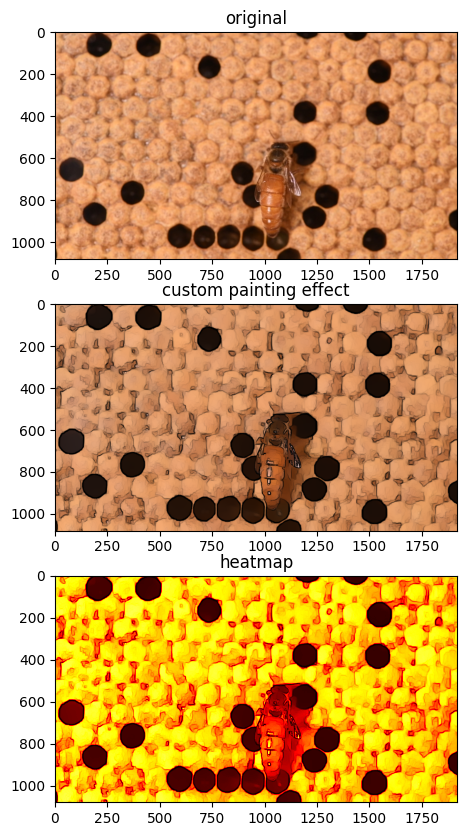

In [66]:
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
plt.imshow(original_img)
plt.title('original')

plt.subplot(3,1,2)
plt.imshow(custom_effect_rgb)
plt.title('custom painting effect')

plt.subplot(3,1,3)
plt.imshow(heatmap, cmap='hot')
plt.title('heatmap')

plt.subplots_adjust(wspace=0.2)

plt.show()

### 허프변환
##### -Circle Hough

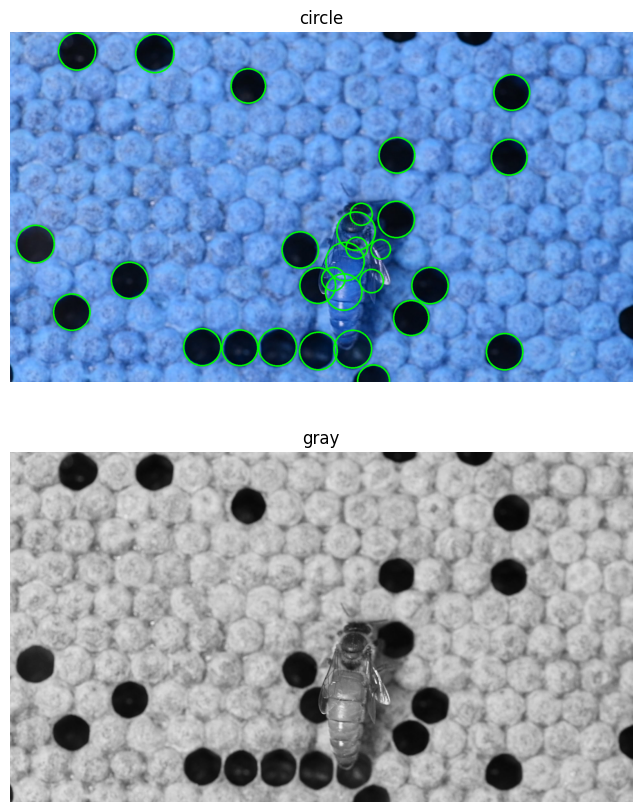

In [73]:
def extract_circle_centers(image_path, min_radius, max_radius, threshold):
    # 이미지 로드
    image = cv2.imread(image_path)
    copy_image = image.copy()    
    gray = cv2.cvtColor(copy_image, cv2.COLOR_BGR2GRAY)
    img_r = copy_image[:,:,0]
    img_g = copy_image[:,:,1]
    img_b = copy_image[:,:,2]
    r_equalized_image = cv2.equalizeHist(img_r)
    g_equalized_image = cv2.equalizeHist(img_g)
    b_equalized_image = cv2.equalizeHist(img_b)
    equalized_image = cv2.merge([r_equalized_image, g_equalized_image, b_equalized_image])
    gray_equalized = cv2.cvtColor(equalized_image, cv2.COLOR_BGR2GRAY)
    
    # Circle Hough 변환 적용
    circles = cv2.HoughCircles(
        gray,
        cv2.HOUGH_GRADIENT,
        dp=1,
        minDist=50,
        param1=80,
        param2=threshold,
        minRadius=min_radius,
        maxRadius=max_radius
    )

    centers = []
    
    if circles is not None:
        circles = np.round(circles[0, :]).astype("int")

        # 출력 확인
        for (x, y, r) in circles:
            cv2.circle(copy_image, (x, y), r, (0, 255, 0), 4)

        plt.figure(figsize=(10,10))

        plt.subplot(2,1,1)
        plt.imshow(copy_image)
        plt.axis('off')  # 축 제거
        plt.title('circle')
        
        plt.subplot(2,1,2)
        plt.imshow(gray,cmap='gray')
        plt.axis('off')  # 축 제거
        plt.title('gray')
        
        plt.show()
        
        # 중심점 반환
        for (x, y, r) in circles:    
            centers.append((x, y))

    return centers


image_path = '/home/hyun425/Yolo/test_image/bee6.jpg'
min_radius = 30  # 최소 반지름 설정
max_radius = 60  # 최대 반지름 설정
threshold = 20   # 임계값 설정

circle_centers = extract_circle_centers(image_path, min_radius, max_radius, threshold)

# for center in circle_centers:
#     print("중심 좌표:", center)
    
# print(len(circle_centers))

### 푸리에 변환

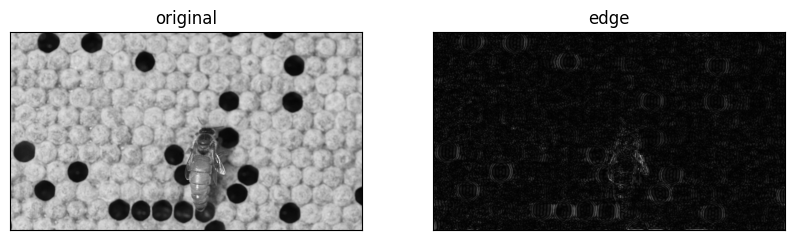

In [74]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# 이미지를 불러오고 그레이 스케일로 변환
image = gray

# Fourier 변환을 위해 이미지 크기를 2의 제곱수로 조정
rows, cols = image.shape
nrows = cv2.getOptimalDFTSize(rows)
ncols = cv2.getOptimalDFTSize(cols)
padded = cv2.copyMakeBorder(image, 0, nrows - rows, 0, ncols - cols, cv2.BORDER_CONSTANT, value=[0, 0])

# 2D Fourier 변환을 수행
f_transform = np.fft.fft2(padded)
f_shift = np.fft.fftshift(f_transform)

# 하이 패스 필터를 생성하여 고주파 부분만 유지
mask = np.ones((nrows, ncols), dtype=np.uint8)
mask[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0

# 주파수 도메인에서 마스크 적용
f_shift = f_shift * mask

# 역 이동 및 역 Fourier 변환
f_ishift = np.fft.ifftshift(f_shift)
image_back = np.fft.ifft2(f_ishift)
image_back = np.abs(image_back)

plt.figure(figsize=(10,10))
# 결과 이미지 출력
plt.subplot(121), plt.imshow(image, cmap="gray")
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(image_back, cmap="gray")
plt.title("edge"), plt.xticks([]), plt.yticks([])

plt.show()

### 대비

###### - 히스토그램 균일화
###### - CLAHE 모델

In [447]:
# RGB 색상모델 R, G, B 채널별 균일화
r_equalized_image = cv2.equalizeHist(original_img[:,:,0])
g_equalized_image = cv2.equalizeHist(original_img[:,:,1])
b_equalized_image = cv2.equalizeHist(original_img[:,:,2])

In [444]:
# R, G, B 채널별 균일화 이미지 합침
equalized_image = cv2.merge([r_equalized_image, g_equalized_image, b_equalized_image])

# 흑백 이미지 균일화
gray_equalized_image = cv2.equalizeHist(original_img_gray)

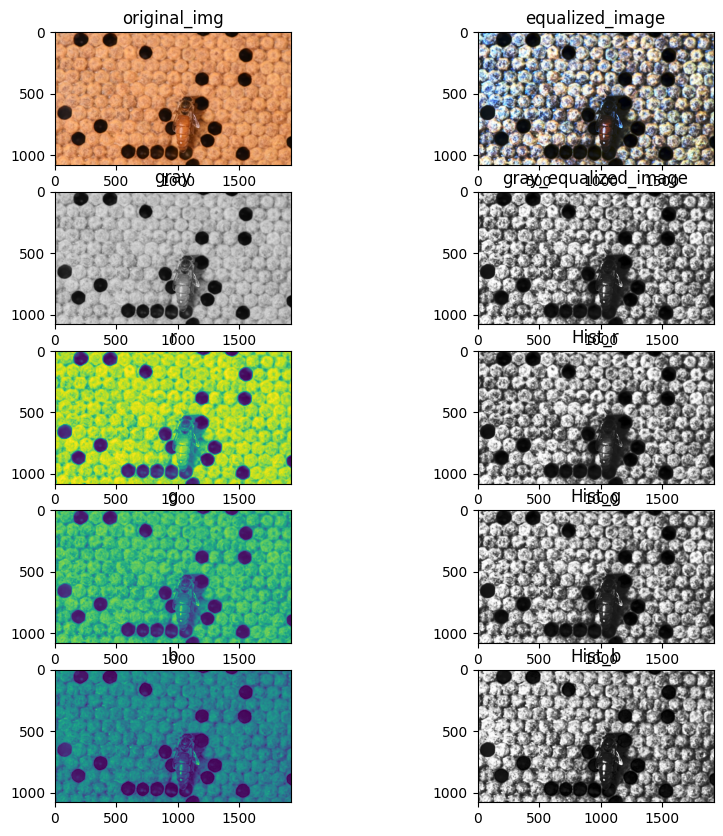

In [448]:
plt.figure(figsize=(10,10))

plt.subplot(5,2,1)
plt.imshow(original_img)
plt.title('original_img')

plt.subplot(5,2,2)
plt.imshow(equalized_image)
plt.title('equalized_image')

plt.subplot(5,2,3)
plt.imshow(original_img_gray, cmap='gray')
plt.title('gray')

plt.subplot(5,2,4)
plt.imshow(gray_equalized_image, cmap='gray')
plt.title('gray_equalized_image')

plt.subplot(5,2,5)
plt.imshow(original_img[:,:,0])
plt.title('r')
           
plt.subplot(5,2,6)
plt.imshow(r_equalized_image, cmap='gray')
plt.title('Hist_r')

plt.subplot(5,2,7)
plt.imshow(original_img[:,:,1])
plt.title('g')

plt.subplot(5,2,8)
plt.imshow(g_equalized_image, cmap='gray')
plt.title('Hist_g')

plt.subplot(5,2,9)
plt.imshow(original_img[:,:,2])
plt.title('b')
           
plt.subplot(5,2,10)
plt.imshow(b_equalized_image, cmap='gray')
plt.title('Hist_b')  
           
plt.show()

Text(0.5, 1.0, 'equalized_image')

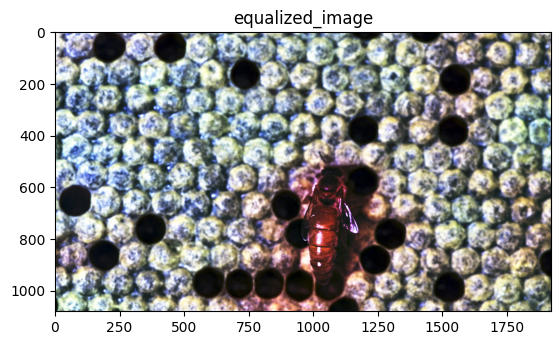

In [288]:
# R, G, B 채널별 균일화 합친 이미지 재확인

plt.imshow(equalized_image)
plt.title('equalized_image')  

In [449]:
# HSV 및 HLS 채널별 다양한 균일화

imgHSV3Ch = cv2.cvtColor(original_img, cv2.COLOR_RGB2HSV)
for i in range(3):
    imgHSV3Ch[:,:,i]=cv2.equalizeHist(imgHSV3Ch[:,:,i])

    
imgHSV2Ch = cv2.cvtColor(original_img, cv2.COLOR_RGB2HSV)
for i in range(1,3):
    imgHSV2Ch[:,:,i]=cv2.equalizeHist(imgHSV2Ch[:,:,i])


imgHLS2Ch = cv2.cvtColor(original_img, cv2.COLOR_RGB2HLS)
for i in range(1,3):
    imgHLS2Ch[:,:,i]=cv2.equalizeHist(imgHLS2Ch[:,:,i])

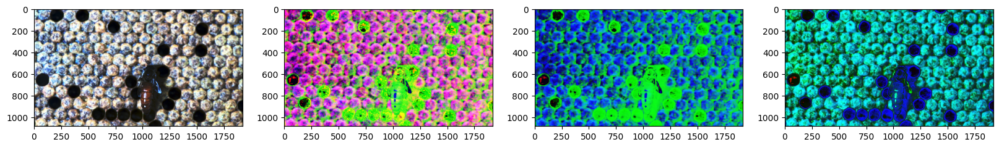

In [451]:
# 대비 적용한 이미지들 비교

plt.figure(figsize=(20,20))
plt.subplot(141)
plt.imshow(equalized_image)
plt.subplot(142)
plt.imshow(imgHSV3Ch)
plt.subplot(143)
plt.imshow(imgHSV2Ch)
plt.subplot(144)
plt.imshow(imgHLS2Ch)

##### CHALE 모델

In [ ]:
# CLAHE 함수 정의
def apply_clahe(image, clip_limit=2.0, tile_size=(8, 8)):
    """
    Apply CLAHE (Contrast Limited Adaptive Histogram Equalization) to an image.

    Parameters:
        - image: 입력 이미지 (grayscale)
        - clip_limit: 클리핑 한계 (0 이상의 실수)
        - tile_size: 타일 크기 (tuple 형태, 예: (8, 8))

    Returns:
        - CLAHE를 적용한 이미지
    """
    # CLAHE 객체 생성
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_size)
    
    # CLAHE 적용
    clahe_image = clahe.apply(image)
    
    return clahe_image

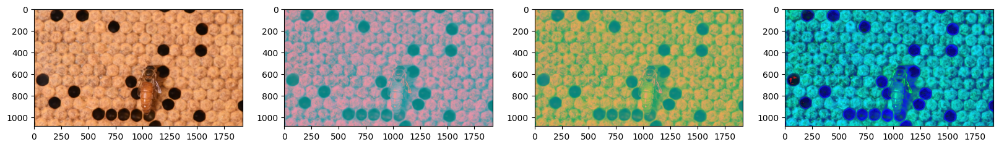

In [453]:
# 밝기 값 채널만 추출
img_LAB = original_img_LAB.copy()
img_LAB[:,:,0] = claheTestL

img_YCrCb = original_img_YCrCb.copy()
img_YCrCb[:,:,0] = claheTestY

img_HLS = original_img_HLS.copy()
img_HLS[:,:,1] = claheTestHL


plt.figure(figsize=(20,20))

plt.subplot(141)
plt.imshow(original_img)

plt.subplot(142)
plt.imshow(img_LAB)

plt.subplot(143)
plt.imshow(img_YCrCb)

plt.subplot(144)
plt.imshow(img_HLS)

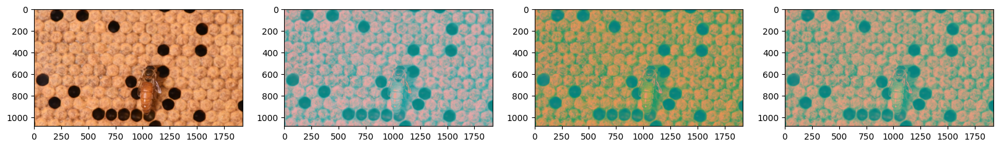

In [307]:
# 이미지 평균값 계산
claheMean = np.mean([img_LAB, img_YCrCb], axis=0).astype(np.uint8)

# 이미지 최대값 계산
claheMax = np.maximum.reduce([img_LAB, img_YCrCb])

# 이미지 최소값 계산
claheMin = np.minimum.reduce([img_LAB, img_YCrCb])

plt.figure(figsize=(20,20))

plt.subplot(141)
plt.imshow(original_img)

plt.subplot(142)
plt.imshow(claheMax)

plt.subplot(143)
plt.imshow(claheMin)

plt.subplot(144)
plt.imshow(claheMean)

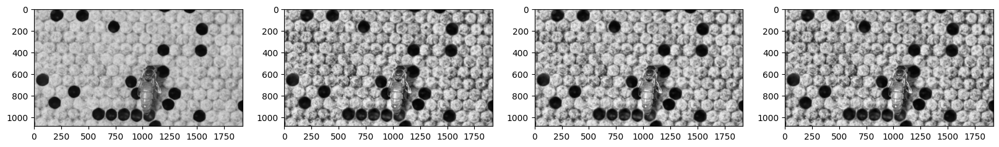

In [457]:
# gray 이미지 

original_img_gray = cv2.cvtColor(original_img, cv2.COLOR_RGB2GRAY)
original_img_LAB = cv2.cvtColor(original_img, cv2.COLOR_RGB2LAB)
original_img_YCrCb = cv2.cvtColor(original_img, cv2.COLOR_RGB2YCrCb)
original_img_HLS = cv2.cvtColor(original_img, cv2.COLOR_RGB2HLS)

claheTest = apply_clahe(original_img_gray)
claheTestL = apply_clahe(original_img_LAB[:,:,0])
claheTestY = apply_clahe(original_img_YCrCb[:,:,0])
claheTestHL = apply_clahe(original_img_HLS[:,:,1])

plt.figure(figsize=(20,20))

plt.subplot(141)
plt.imshow(original_img_gray, cmap="gray")

plt.subplot(142)
plt.imshow(claheTest, cmap="gray")

plt.subplot(143)
plt.imshow(claheTestL, cmap="gray")

plt.subplot(144)
plt.imshow(claheTestY, cmap="gray")

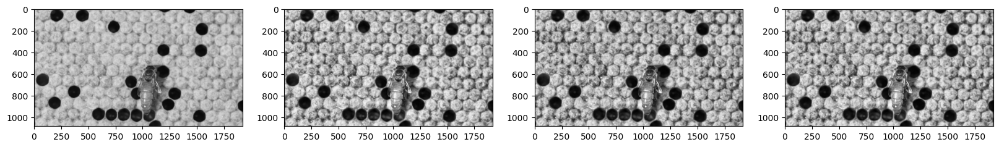

In [320]:
# 이미지 평균값 계산
claheMeanGray = np.mean([claheTestL, claheTestHL, claheTestY], axis=0).astype(np.uint8)

# 이미지 최대값 계산
claheMaxGray = np.maximum.reduce([claheTestL, claheTestHL, claheTestY])

# 이미지 최소값 계산
claheMinGray = np.minimum.reduce([claheTestL, claheTestHL, claheTestY])

plt.figure(figsize=(20,20))

plt.subplot(141)
plt.imshow(original_img_gray,cmap="gray")

plt.subplot(142)
plt.imshow(claheMaxGray,cmap="gray")

plt.subplot(143)
plt.imshow(claheMinGray,cmap="gray")

plt.subplot(144)
plt.imshow(claheMeanGray,cmap="gray")

### 샤프닝

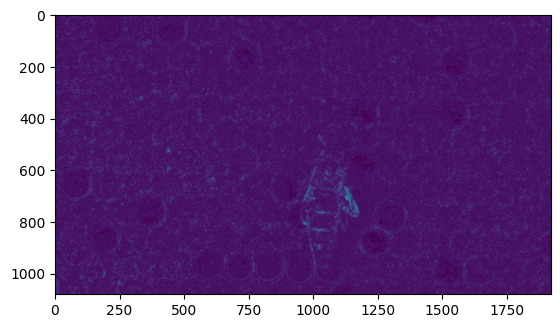

In [459]:
# 라플라시안 이미지 확인

# 블러링을 통한 이미지 부드럽게 만들기
blurred = cv2.GaussianBlur(claheMinGray, (11, 11), 0)  # 가우시안 블러 적용 (커널 크기 조절 가능)

# 라플라시안 필터 적용
laplacian = cv2.Laplacian(blurred, cv2.CV_64F)

# 라플라시안 이미지를 부호 없는 8비트 이미지로 변환 (음수 값 제거)
laplacian = np.uint8(np.absolute(laplacian))

plt.imshow(laplacian)

Text(0.5, 1.0, 'sharpened_claheMean')

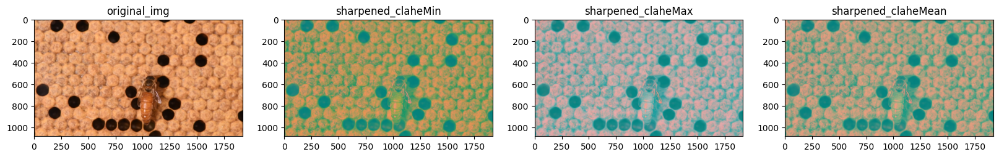

In [310]:
#샤프닝 test

import cv2
import numpy as np

# 블러링을 통한 이미지 부드럽게 만들기
blurredMin = cv2.GaussianBlur(claheMin, (11, 11), 0)  # 가우시안 블러 적용 (커널 크기 조절 가능)
blurredMax = cv2.GaussianBlur(claheMax, (11, 11), 0)  # 가우시안 블러 적용 (커널 크기 조절 가능)
blurredMean = cv2.GaussianBlur(claheMean, (11, 11), 0)  # 가우시안 블러 적용 (커널 크기 조절 가능)

# 라플라시안 필터 적용
laplacianMin = cv2.Laplacian(blurredMin, cv2.CV_64F)
laplacianMax = cv2.Laplacian(blurredMax, cv2.CV_64F)
laplacianMean = cv2.Laplacian(blurredMean, cv2.CV_64F)

# 라플라시안 이미지를 부호 없는 8비트 이미지로 변환 (음수 값 제거)
laplacianMin = np.uint8(np.absolute(laplacianMin))
laplacianMax = np.uint8(np.absolute(laplacianMax))
laplacianMean = np.uint8(np.absolute(laplacianMean))

claheMinSharpe = claheMin.copy()
claheMaxSharpe = claheMax.copy()
claheMeanSharpe = claheMean.copy()

claheMinSharpe = cv2.addWeighted(claheMin, 1, laplacianMin, -0.5, 0)
claheMinSharpe = cv2.addWeighted(claheMin, 1, laplacianMin, -0.5, 0)
claheMaxSharpe = cv2.addWeighted(claheMax, 1, laplacianMax, -0.5, 0)
claheMeanSharpe = cv2.addWeighted(claheMean, 1, laplacianMean, -0.5, 0)

plt.figure(figsize=(20,20))

plt.subplot(141)
plt.imshow(original_img, cmap="gray")
plt.title("original_img")

plt.subplot(142)
plt.imshow(claheMinSharpe, cmap="gray")
plt.title("sharpened_claheMin")

plt.subplot(143)
plt.imshow(claheMaxSharpe, cmap="gray")
plt.title("sharpened_claheMax")

plt.subplot(144)
plt.imshow(claheMeanSharpe, cmap="gray")
plt.title("sharpened_claheMean")

Text(0.5, 1.0, 'sharpened_claheMaxGray')

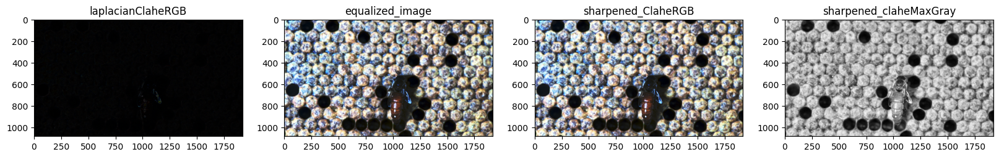

In [456]:
import cv2
import numpy as np

# 이미지 로드

# 블러링을 통한 이미지 부드럽게 만들기
blurredClaheRGB = cv2.GaussianBlur(equalized_image, (3, 3), 0)  # 가우시안 블러 적용 (커널 크기 조절 가능)

# 라플라시안 필터 적용
laplacianClaheRGB = cv2.Laplacian(blurredClaheRGB, cv2.CV_64F)


# 라플라시안 이미지를 부호 없는 8비트 이미지로 변환 (음수 값 제거)
laplacianClaheRGB = np.uint8(np.absolute(laplacianClaheRGB))

# 원본 이미지에 라플라시안 이미지를 결합하여 샤프닝
sharpened_ClaheRGB = cv2.addWeighted(equalized_image, 1., laplacianClaheRGB, 0.5, 0)

plt.figure(figsize=(20,20))

plt.subplot(141)
plt.imshow(laplacianClaheRGB)
plt.title("laplacianClaheRGB")

plt.subplot(142)
plt.imshow(equalized_image)
plt.title("equalized_image")

plt.subplot(143)
plt.imshow(sharpened_ClaheRGB)
plt.title("sharpened_ClaheRGB")

plt.subplot(144)
plt.imshow(sharpened_claheMaxGray, cmap="gray")
plt.title("sharpened_claheMaxGray")

Text(0.5, 1.0, 'sharpened_claheMean')

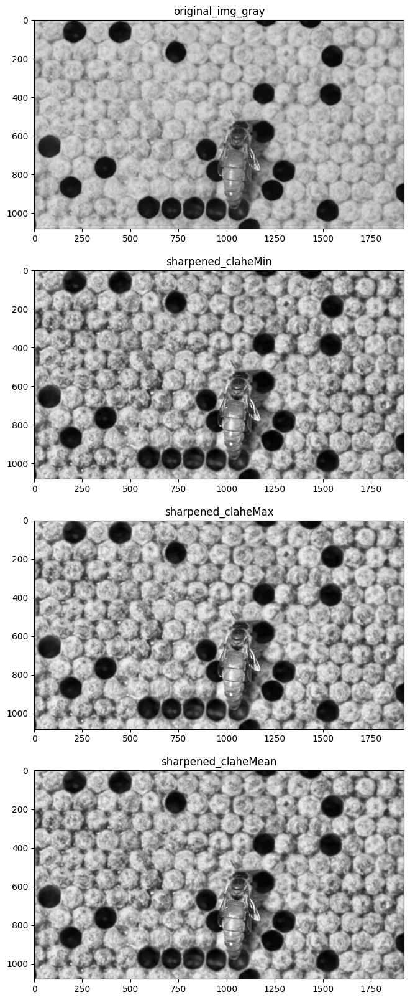

In [322]:
import cv2
import numpy as np

# 이미지 로드

# 블러링을 통한 이미지 부드럽게 만들기
blurredMin = cv2.GaussianBlur(claheMinGray, (11, 11), 0)  # 가우시안 블러 적용 (커널 크기 조절 가능)
blurredMax = cv2.GaussianBlur(claheMaxGray, (11, 11), 0)  # 가우시안 블러 적용 (커널 크기 조절 가능)
blurredMean = cv2.GaussianBlur(claheMeanGray, (11, 11), 0)  # 가우시안 블러 적용 (커널 크기 조절 가능)


# 라플라시안 필터 적용
laplacianMin = cv2.Laplacian(blurredMin, cv2.CV_64F)
laplacianMax = cv2.Laplacian(blurredMax, cv2.CV_64F)
laplacianMean = cv2.Laplacian(blurredMean, cv2.CV_64F)

# 라플라시안 이미지를 부호 없는 8비트 이미지로 변환 (음수 값 제거)
laplacianMin = np.uint8(np.absolute(laplacianMin))
laplacianMax = np.uint8(np.absolute(laplacianMax))
laplacianMean = np.uint8(np.absolute(laplacianMean))

# 원본 이미지에 라플라시안 이미지를 결합하여 샤프닝
sharpened_org = cv2.addWeighted(original_img_gray, 1, laplacian, 1.5, 0)

sharpened_claheMinGray = cv2.addWeighted(claheMinGray, 1, laplacianMin, 1.5, 0)

sharpened_claheMaxGray = cv2.addWeighted(claheMaxGray, 1, laplacianMax, 1.5, 0)

sharpened_claheMeanGray = cv2.addWeighted(claheMeanGray, 1, laplacianMean, 1.5, 0)

plt.figure(figsize=(20,20))

plt.subplot(411)
plt.imshow(original_img_gray, cmap="gray")
plt.title("original_img_gray")

plt.subplot(412)
plt.imshow(sharpened_claheMinGray, cmap="gray")
plt.title("sharpened_claheMin")

plt.subplot(413)
plt.imshow(sharpened_claheMaxGray, cmap="gray")
plt.title("sharpened_claheMax")

plt.subplot(414)
plt.imshow(sharpened_claheMeanGray, cmap="gray")
plt.title("sharpened_claheMean")

In [330]:
import cv2
import numpy as np

def apply_filter(image, filter):
    # 이미지를 그레이 스케일로 변환

    # Fourier 변환을 위해 이미지 크기를 2의 제곱수로 조정
    rows, cols = image.shape
    nrows = cv2.getOptimalDFTSize(rows)
    ncols = cv2.getOptimalDFTSize(cols)
    padded = np.pad(image, ((0, nrows - rows), (0, ncols - cols)), mode='reflect')

    # 2D Fourier 변환 수행
    f_transform = np.fft.fft2(padded)
    f_shift = np.fft.fftshift(f_transform)

    # 주파수 도메인에서 필터 적용
    f_shift_filtered = f_shift * filter

    # 역 이동 및 역 Fourier 변환
    f_ishift = np.fft.ifftshift(f_shift_filtered)
    image_back = np.fft.ifft2(f_ishift)
    image_back = np.abs(image_back)

    return image_back

# 입력 이미지를 불러옵니다.
input_image = sharpened_claheMinGray

# Low Pass Filter(LPF)를 생성하여 고주파 부분 제거
LPF_filter = np.ones_like(input_image, dtype=np.uint8)
LPF_filter[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거
HPF_filter_vertical = np.copy(LPF_filter)
HPF_filter_vertical = 1 - HPF_filter_vertical  # LPF와 반전

HPF_filter_horizontal = np.copy(LPF_filter)
HPF_filter_horizontal = 1 - HPF_filter_horizontal
HPF_filter_horizontal = np.transpose(HPF_filter_horizontal)  # LPF와 반전 및 수평 방향으로

# 대각선 방향으로 High Pass Filter(HPF)를 생성하여 저주파 부분 제거
HPF_filter_diagonal = np.copy(LPF_filter)
HPF_filter_diagonal = 1 - HPF_filter_diagonal
HPF_filter_diagonal = np.fliplr(HPF_filter_diagonal)  # LPF와 반전 및 대각선 방향으로

# 각 필터를 이미지에 적용하여 결과 이미지 생성
LL_result = apply_filter(input_image, LPF_filter)
HL_result = apply_filter(input_image, HPF_filter_vertical)
LH_result = apply_filter(input_image, HPF_filter_horizontal)
HH_result = apply_filter(input_image, HPF_filter_diagonal)



ValueError: operands could not be broadcast together with shapes (1080,1920) (1920,1080) 

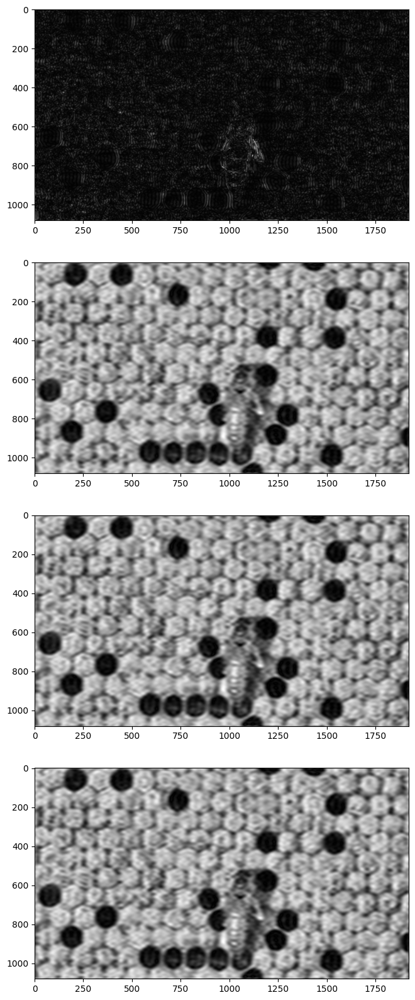

In [338]:
import cv2
import numpy as np

def apply_filter(image, filter):
    # 이미지를 그레이 스케일로 변환

    # Fourier 변환을 위해 이미지 크기를 2의 제곱수로 조정
    rows, cols = image.shape
    nrows = cv2.getOptimalDFTSize(rows)
    ncols = cv2.getOptimalDFTSize(cols)
    padded = np.pad(image, ((0, nrows - rows), (0, ncols - cols)), mode='reflect')

    # 2D Fourier 변환 수행
    f_transform = np.fft.fft2(padded)
    f_shift = np.fft.fftshift(f_transform)

    # 주파수 도메인에서 필터 적용
    f_shift_filtered = f_shift * filter

    # 역 이동 및 역 Fourier 변환
    f_ishift = np.fft.ifftshift(f_shift_filtered)
    image_back = np.fft.ifft2(f_ishift)
    image_back = np.abs(image_back)

    return image_back

# 입력 이미지를 불러옵니다.
input_image = sharpened_claheMinGray

# Low Pass Filter(LPF)를 생성하여 고주파 부분 제거
LPF_filter = np.ones_like(input_image, dtype=np.uint8)
LPF_filter[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거
HPF_filter_vertical = np.copy(LPF_filter)
HPF_filter_vertical = 1 - HPF_filter_vertical  # LPF와 반전

HPF_filter_horizontal = np.copy(LPF_filter)
HPF_filter_horizontal = 1 - HPF_filter_horizontal
HPF_filter_horizontal = np.pad(HPF_filter_horizontal, ((0, nrows - input_image.shape[0]), (0, ncols - input_image.shape[1])), mode='reflect')

# 대각선 방향으로 High Pass Filter(HPF)를 생성하여 저주파 부분 제거
HPF_filter_diagonal = np.copy(LPF_filter)
HPF_filter_diagonal = 1 - HPF_filter_diagonal
HPF_filter_diagonal = np.pad(HPF_filter_diagonal, ((0, nrows - input_image.shape[0]), (0, ncols - input_image.shape[1])), mode='reflect')

# 각 필터를 이미지에 적용하여 결과 이미지 생성
LL_result = apply_filter(input_image, LPF_filter)
HL_result = apply_filter(input_image, HPF_filter_vertical)
LH_result = apply_filter(input_image, HPF_filter_horizontal)
HH_result = apply_filter(input_image, HPF_filter_diagonal)

# 결과 이미지를 출력

plt.figure(figsize=(20,20))

plt.subplot(411)
plt.imshow(LL_result, cmap="gray")
plt.subplot(412)
plt.imshow(HL_result, cmap="gray")
plt.subplot(413)
plt.imshow(LH_result, cmap="gray")
plt.subplot(414)
plt.imshow(HH_result, cmap="gray")



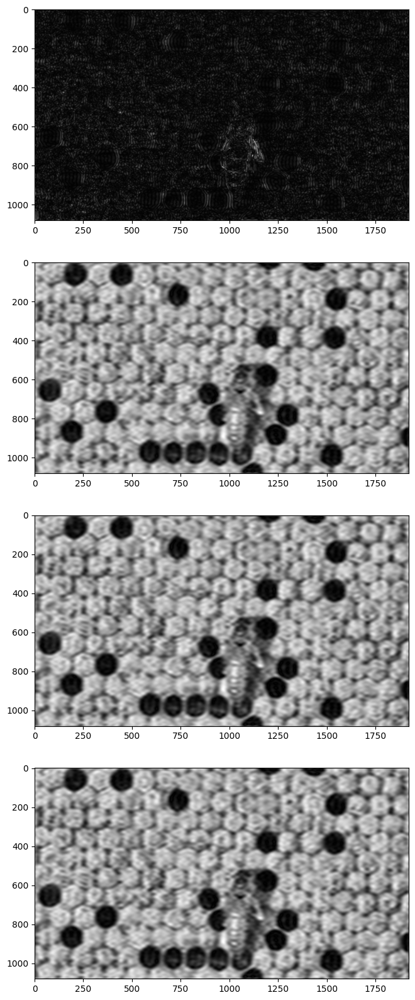

In [340]:
import cv2
import numpy as np

def apply_filter(image, filter):
    # 이미지를 그레이 스케일로 변환

    # Fourier 변환을 위해 이미지 크기를 2의 제곱수로 조정
    rows, cols = image.shape
    nrows = cv2.getOptimalDFTSize(rows)
    ncols = cv2.getOptimalDFTSize(cols)
    padded = np.pad(image, ((0, nrows - rows), (0, ncols - cols)), mode='reflect')

    # 2D Fourier 변환 수행
    f_transform = np.fft.fft2(padded)
    f_shift = np.fft.fftshift(f_transform)

    # 주파수 도메인에서 필터 적용
    f_shift_filtered = f_shift * filter

    # 역 이동 및 역 Fourier 변환
    f_ishift = np.fft.ifftshift(f_shift_filtered)
    image_back = np.fft.ifft2(f_ishift)
    image_back = np.abs(image_back)

    return image_back

# 입력 이미지를 불러옵니다.
input_image = sharpened_claheMinGray

# Low Pass Filter(LPF)를 생성하여 고주파 부분 제거
LPF_filter = np.ones_like(input_image, dtype=np.uint8)
LPF_filter[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0

# High Pass Filter(HPF)를 생성하여 고주파 부분 강조
HPF_filter = 1 - LPF_filter  # LPF와 반전

# 각 필터를 이미지에 적용하여 결과 이미지 생성
LL_result = apply_filter(input_image, LPF_filter)
HL_result = apply_filter(input_image, HPF_filter)
LH_result = apply_filter(input_image, HPF_filter)
HH_result = apply_filter(input_image, HPF_filter)

# 결과 이미지를 출력
plt.figure(figsize=(20,20))

plt.subplot(411)
plt.imshow(LL_result, cmap="gray")
plt.subplot(412)
plt.imshow(HL_result, cmap="gray")
plt.subplot(413)
plt.imshow(LH_result, cmap="gray")
plt.subplot(414)
plt.imshow(HH_result, cmap="gray")

plt.show()


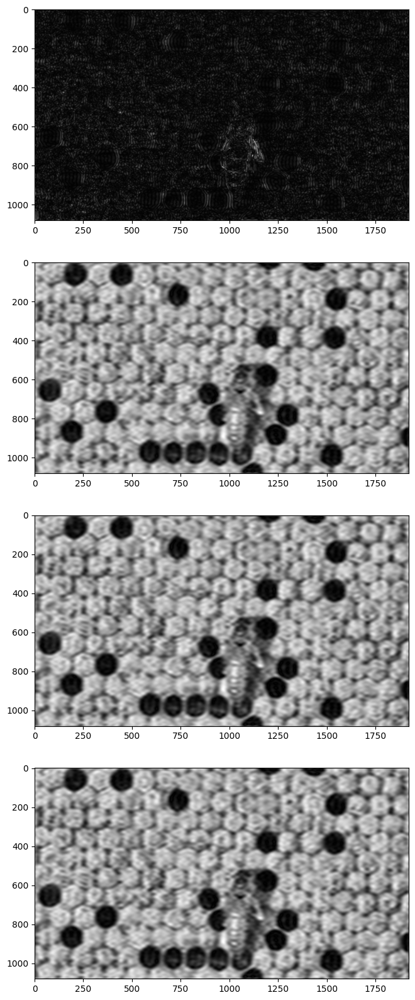

In [352]:
import cv2
import numpy as np

def apply_filter(image, filter):
    # 이미지를 그레이 스케일로 변환

    # Fourier 변환을 위해 이미지 크기를 2의 제곱수로 조정
    rows, cols = image.shape
    nrows = cv2.getOptimalDFTSize(rows)
    ncols = cv2.getOptimalDFTSize(cols)
    padded = np.pad(image, ((0, nrows - rows), (0, ncols - cols)), mode='reflect')

    # 2D Fourier 변환 수행
    f_transform = np.fft.fft2(padded)
    f_shift = np.fft.fftshift(f_transform)

    # 주파수 도메인에서 필터 적용
    f_shift_filtered = f_shift * filter

    # 역 이동 및 역 Fourier 변환
    f_ishift = np.fft.ifftshift(f_shift_filtered)
    image_back = np.fft.ifft2(f_ishift)
    image_back = np.abs(image_back)

    return image_back

# 입력 이미지를 불러옵니다.
input_image = sharpened_claheMinGray

# Low Pass Filter(LPF)를 생성하여 고주파 부분 제거
LPF_filter = np.ones_like(input_image, dtype=np.uint8)
LPF_filter[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0

# High Pass Filter(HPF)를 생성하여 고주파 부분 강조
HPF_filter = 1 - LPF_filter  # LPF와 반전

# 각 필터를 이미지에 적용하여 결과 이미지 생성
LL_result = apply_filter(input_image, LPF_filter)
HL_result = apply_filter(input_image, HPF_filter)
LH_result = apply_filter(input_image, HPF_filter)
HH_result = apply_filter(input_image, HPF_filter)

# 결과 이미지를 출력
plt.figure(figsize=(20,20))

plt.subplot(411)
plt.imshow(LL_result, cmap="gray")
plt.subplot(412)
plt.imshow(HL_result, cmap="gray")
plt.subplot(413)
plt.imshow(LH_result, cmap="gray")
plt.subplot(414)
plt.imshow(HH_result, cmap="gray")

plt.show()


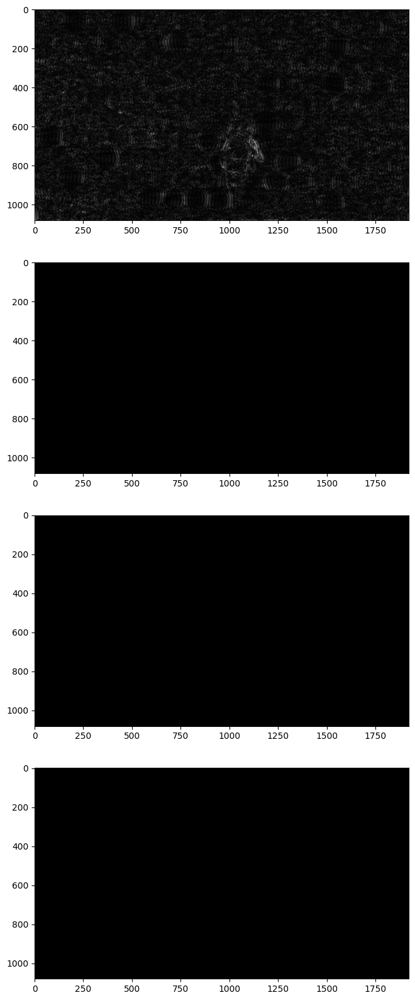

In [361]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def apply_filter(image, filter):
    # 이미지를 그레이 스케일로 변환
    rows, cols = image.shape
    nrows = cv2.getOptimalDFTSize(rows)
    ncols = cv2.getOptimalDFTSize(cols)
    padded = np.pad(image, ((0, nrows - rows), (0, ncols - cols)), mode='reflect')

    # 2D Fourier 변환 수행
    f_transform = np.fft.fft2(padded)
    f_shift = np.fft.fftshift(f_transform)

    # 주파수 도메인에서 필터 적용
    f_shift_filtered = f_shift * filter

    # 역 이동 및 역 Fourier 변환
    f_ishift = np.fft.ifftshift(f_shift_filtered)
    image_back = np.fft.ifft2(f_ishift)
    image_back = np.abs(image_back)

    return image_back

# 입력 이미지를 불러옵니다.
input_image = sharpened_claheMinGray  # 흑백 이미지로 가정합니다.

# Low Pass Filter(LPF)를 생성하여 고주파 부분 제거
LPF_filter = np.ones_like(input_image, dtype=np.uint8)
nrows, ncols = input_image.shape
LPF_filter[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0

# 각 방향에 대한 High Pass Filter(HPF)를 생성
HPF_filter_horizontal = np.copy(LPF_filter)
HPF_filter_horizontal[:, ncols//2-50:ncols//2+50] = 1  # 가로 방향 고주파 강조
HPF_filter_horizontal = 1 - HPF_filter_horizontal

HPF_filter_diagonal = np.copy(LPF_filter)
HPF_filter_diagonal[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 1  # 대각선 방향 고주파 강조
HPF_filter_diagonal = 1 - HPF_filter_diagonal

# 각 방향에 대해 필터를 이미지에 적용하여 결과 이미지 생성
LL_result = apply_filter(input_image, LPF_filter)
HL_result = apply_filter(input_image, HPF_filter_horizontal)
LH_result = apply_filter(input_image, HPF_filter_horizontal)  # horizontal 대신 vertical로 수정
HH_result = apply_filter(input_image, HPF_filter_diagonal)

# 결과 이미지를 출력
plt.figure(figsize=(20,20))

plt.subplot(411)
plt.imshow(LL_result, cmap="gray")
plt.subplot(412)
plt.imshow(HL_result, cmap="gray")
plt.subplot(413)
plt.imshow(LH_result, cmap="gray")
plt.subplot(414)
plt.imshow(HH_result, cmap="gray")

plt.show()

In [362]:
! {sys.executable} -m pip install PyWavelets

  Using cached PyWavelets-1.4.1-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (6.8 MB)


In [373]:
sharpened_claheMinGray.shape

(1080, 1920)

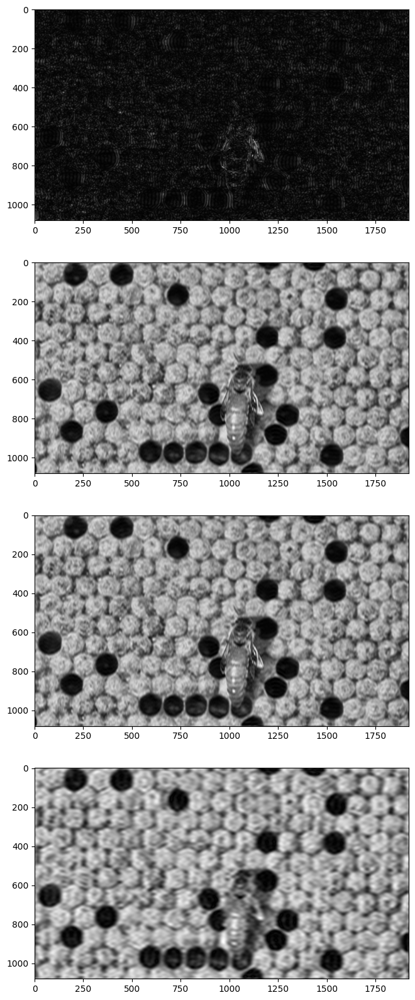

In [394]:
import cv2
import numpy as np

def apply_filter(image, filter):
    # 이미지를 그레이 스케일로 변환
 
    # Fourier 변환을 위해 이미지 크기를 2의 제곱수로 조정
    rows, cols = image.shape
    nrows = cv2.getOptimalDFTSize(rows)
    ncols = cv2.getOptimalDFTSize(cols)
    padded = np.pad(image, ((0, nrows - rows), (0, ncols - cols)), mode='reflect')

    # 2D Fourier 변환 수행
    f_transform = np.fft.fft2(padded)
    f_shift = np.fft.fftshift(f_transform)

    # 주파수 도메인에서 필터 적용
    f_shift_filtered = f_shift * filter

    # 역 이동 및 역 Fourier 변환
    f_ishift = np.fft.ifftshift(f_shift_filtered)
    image_back = np.fft.ifft2(f_ishift)
    image_back = np.abs(image_back)

    return image_back

# 입력 이미지를 불러옵니다.
input_image = sharpened_claheMinGray

# Low Pass Filter(LPF)를 생성하여 고주파 부분 제거
LPF_filter = np.ones_like(input_image, dtype=np.uint8)
LPF_filter[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (수직 방향)
HPF_filter_vertical = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_vertical[:nrows//2-50, :] = 0
HPF_filter_vertical[nrows//2+50:, :] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (수평 방향)
HPF_filter_horizontal = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_horizontal[:, :ncols//2-50] = 0
HPF_filter_horizontal[:, ncols//2+50:] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (대각 방향)
HPF_filter_diagonal = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_diagonal[:nrows//2-50, :] = 0
HPF_filter_diagonal[:, :ncols//2-50] = 0
HPF_filter_diagonal[nrows//2+50:, :] = 0
HPF_filter_diagonal[:, ncols//2+50:] = 0

# 각 필터를 이미지에 적용하여 결과 이미지 생성
LL_result = apply_filter(input_image, LPF_filter)
HL_result = apply_filter(input_image, HPF_filter_vertical)
LH_result = apply_filter(input_image, HPF_filter_horizontal)
HH_result = apply_filter(input_image, HPF_filter_diagonal)

# 결과 이미지를 출력

plt.figure(figsize=(20,20))

plt.subplot(411)
plt.imshow(LL_result, cmap="gray")
plt.subplot(412)
plt.imshow(HL_result, cmap="gray")
plt.subplot(413)
plt.imshow(HL_result, cmap="gray")
plt.subplot(414)
plt.imshow(HH_result, cmap="gray")


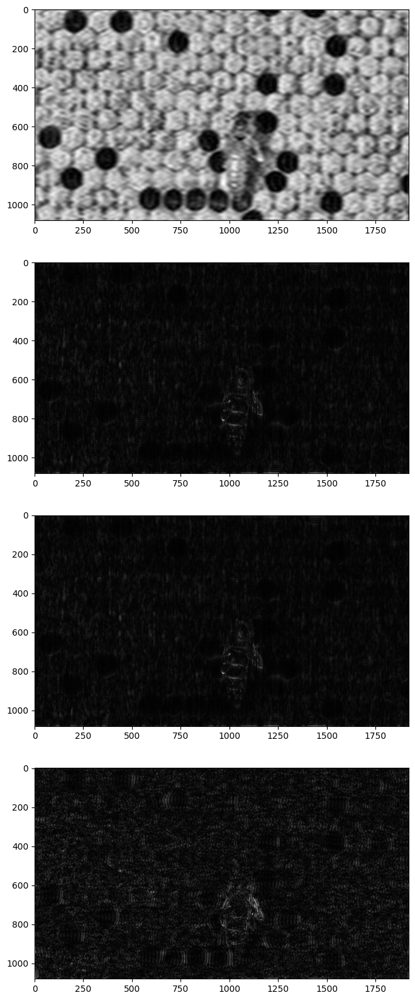

In [396]:
import cv2
import numpy as np

def apply_filter(image, filter):
    # 이미지를 그레이 스케일로 변환
 
    # Fourier 변환을 위해 이미지 크기를 2의 제곱수로 조정
    rows, cols = image.shape
    nrows = cv2.getOptimalDFTSize(rows)
    ncols = cv2.getOptimalDFTSize(cols)
    padded = np.pad(image, ((0, nrows - rows), (0, ncols - cols)), mode='reflect')

    # 2D Fourier 변환 수행
    f_transform = np.fft.fft2(padded)
    f_shift = np.fft.fftshift(f_transform)

    # 주파수 도메인에서 필터 적용
    f_shift_filtered = f_shift * filter

    # 역 이동 및 역 Fourier 변환
    f_ishift = np.fft.ifftshift(f_shift_filtered)
    image_back = np.fft.ifft2(f_ishift)
    image_back = np.abs(image_back)

    return image_back

# 입력 이미지를 불러옵니다.
input_image = sharpened_claheMinGray

# Low Pass Filter(LPF)를 생성하여 고주파 부분 제거
LPF_filter = np.ones_like(input_image, dtype=np.uint8)
LPF_filter[:nrows//2-50, :] = 0
LPF_filter[nrows//2+50:, :] = 0
LPF_filter[:, :ncols//2-50] = 0
LPF_filter[:, ncols//2+50:] = 0


# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (수직 방향)
HPF_filter_vertical = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_vertical[nrows//2-50:nrows//2+50, :] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (수평 방향)
HPF_filter_horizontal = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_horizontal[:, ncols//2-50:ncols//2+50] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (대각 방향)
HPF_filter_diagonal = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_diagonal[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0



# 각 필터를 이미지에 적용하여 결과 이미지 생성
LL_result = apply_filter(input_image, LPF_filter)
HL_result = apply_filter(input_image, HPF_filter_vertical)
LH_result = apply_filter(input_image, HPF_filter_horizontal)
HH_result = apply_filter(input_image, HPF_filter_diagonal)

# 결과 이미지를 출력

plt.figure(figsize=(20,20))

plt.subplot(411)
plt.imshow(LL_result, cmap="gray")
plt.subplot(412)
plt.imshow(HL_result, cmap="gray")
plt.subplot(413)
plt.imshow(HL_result, cmap="gray")
plt.subplot(414)
plt.imshow(HH_result, cmap="gray")


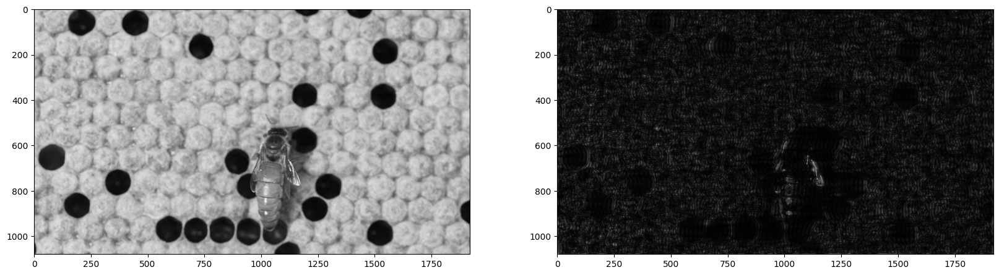

In [437]:
reconstructed_image = HL_result + LH_result + HH_result

plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(original_img_gray, cmap="gray")
plt.subplot(122)
plt.imshow(reconstructed_image, cmap="gray")

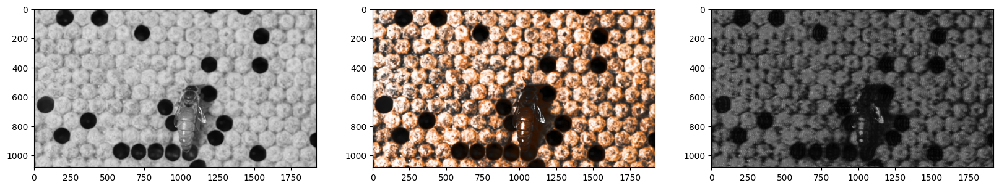

In [432]:
import cv2
import numpy as np

imgHSV2Ch = cv2.cvtColor(original_img, cv2.COLOR_RGB2HLS)

for i in range(1,3):
    imgHSV2Ch[:,:,i]=cv2.equalizeHist(imgHSV2Ch[:,:,i])
    

def apply_filter(image, filter):
    # 이미지를 그레이 스케일로 변환
 
    # Fourier 변환을 위해 이미지 크기를 2의 제곱수로 조정
    rows, cols = image.shape
    nrows = cv2.getOptimalDFTSize(rows)
    ncols = cv2.getOptimalDFTSize(cols)
    padded = np.pad(image, ((0, nrows - rows), (0, ncols - cols)), mode='reflect')

    # 2D Fourier 변환 수행
    f_transform = np.fft.fft2(padded)
    f_shift = np.fft.fftshift(f_transform)

    # 주파수 도메인에서 필터 적용
    f_shift_filtered = f_shift * filter

    # 역 이동 및 역 Fourier 변환
    f_ishift = np.fft.ifftshift(f_shift_filtered)
    image_back = np.fft.ifft2(f_ishift)
    image_back = np.abs(image_back)

    return image_back

# 입력 이미지를 불러옵니다.

imgHSV2ChGray = cv2.cvtColor(imgHLS2ChRGB, cv2.COLOR_RGB2GRAY)
input_image = imgHSV2ChGray

# Low Pass Filter(LPF)를 생성하여 고주파 부분 제거
LPF_filter = np.ones_like(input_image, dtype=np.uint8)
LPF_filter[:nrows//2-50, :] = 0
LPF_filter[nrows//2+50:, :] = 0
LPF_filter[:, :ncols//2-50] = 0
LPF_filter[:, ncols//2+50:] = 0


# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (수직 방향)
HPF_filter_vertical = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_vertical[nrows//2-50:nrows//2+50, :] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (수평 방향)
HPF_filter_horizontal = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_horizontal[:, ncols//2-50:ncols//2+50] = 0

# High Pass Filter(HPF)를 생성하여 저주파 부분 제거 (대각 방향)
HPF_filter_diagonal = np.ones_like(input_image, dtype=np.uint8)
HPF_filter_diagonal[nrows//2-50:nrows//2+50, ncols//2-50:ncols//2+50] = 0



# 각 필터를 이미지에 적용하여 결과 이미지 생성
LL_result = apply_filter(input_image, LPF_filter)
HL_result = apply_filter(input_image, HPF_filter_vertical)
LH_result = apply_filter(input_image, HPF_filter_horizontal)
HH_result = apply_filter(input_image, HPF_filter_diagonal)

# 합침
reconstructed_image = LL_result + HL_result + LH_result + HH_result

plt.figure(figsize=(20,20))
plt.subplot(131)
plt.imshow(original_img_gray, cmap="gray")
plt.subplot(132)
plt.imshow(imgHLS2ChRGB, cmap="gray")
plt.subplot(133)
plt.imshow(reconstructed_image, cmap="gray")

In [431]:
pwd

'/home/dlawodud0484/frame_imageprocessing'

In [434]:
cv2.imwrite("HLS2ChannelHistRGB.jpg", imgHLS2ChRGB)
cv2.imwrite("HLS2ChannelHistRGBFt.jpg", reconstructed_image)

True

In [323]:
import cv2

# 두 개의 이미지 불러오기
image1 = original_img_gray
image2 = sharpened_claheMinGray

# 히스토그램 계산
hist1 = cv2.calcHist([image1], [0], None, [256], [0, 256])
hist2 = cv2.calcHist([image2], [0], None, [256], [0, 256])

# 히스토그램 차이 계산 (차이의 절대값)
hist_diff = cv2.absdiff(hist1, hist2)

# 두 히스토그램 차이의 합을 계산
hist_diff_sum = hist_diff.sum()

print("히스토그램 차이:", hist_diff_sum)

히스토그램 차이: 1600356.0


히스토그램 차이: 32276.0


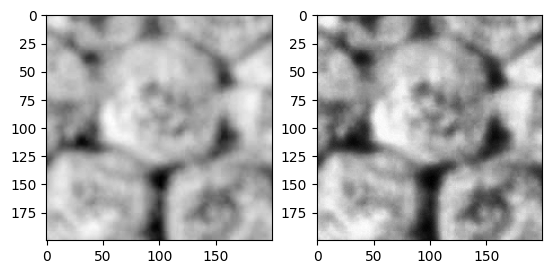

In [327]:
import cv2

# 두 개의 이미지 불러오기
image1 = original_img_gray[0:200,925:1125]
image2 = sharpened_claheMinGray[0:200,925:1125]

# 히스토그램 계산
hist1 = cv2.calcHist([image1], [0], None, [256], [0, 256])
hist2 = cv2.calcHist([image2], [0], None, [256], [0, 256])

# 히스토그램 차이 계산 (차이의 절대값)
hist_diff = cv2.absdiff(hist1, hist2)

# 두 히스토그램 차이의 합을 계산
hist_diff_sum = hist_diff.sum()

plt.subplot(121)
plt.imshow(image1, cmap="gray")

plt.subplot(122)
plt.imshow(image2, cmap="gray")

print("히스토그램 차이:", hist_diff_sum)

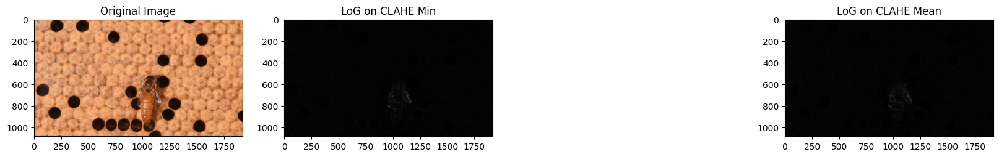

In [267]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


# LoG 필터 적용 함수
def apply_log_filter(img):
    log_image = cv2.GaussianBlur(img, (0, 0), sigmaX=0.1, sigmaY=0.1)
    log_image = cv2.Laplacian(log_image, cv2.CV_64F)
    log_image = cv2.convertScaleAbs(log_image)
    return log_image

# 이미지에 LoG 필터 적용
log_claheMaxGray = apply_log_filter(claheMaxGray)
log_claheMinGray = apply_log_filter(claheMinGray)
log_claheMeanGray = apply_log_filter(claheMeanGray)

# 시각화
plt.figure(figsize=(20, 20))

plt.subplot(141)
plt.imshow(original_img)
plt.title('Original Image')

plt.subplot(142)
plt.imshow(log_claheMaxGray, cmap='gray')
plt.title('LoG on CLAHE Max')

plt.subplot(142)
plt.imshow(log_claheMinGray, cmap='gray')
plt.title('LoG on CLAHE Min')

plt.subplot(144)
plt.imshow(log_claheMeanGray, cmap='gray')
plt.title('LoG on CLAHE Mean')

plt.show()


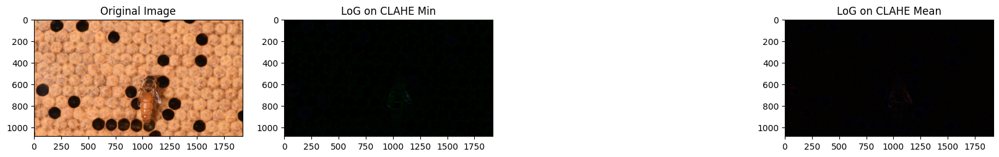

In [269]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


# LoG 필터 적용 함수
def apply_log_filter(img):
    log_image = cv2.GaussianBlur(img, (0, 0), sigmaX=0.1, sigmaY=0.1)
    log_image = cv2.Laplacian(log_image, cv2.CV_64F)
    log_image = cv2.convertScaleAbs(log_image)
    return log_image

# 이미지에 LoG 필터 적용
log_claheMax = apply_log_filter(claheMax)
log_claheMin = apply_log_filter(claheMin)
log_claheMean = apply_log_filter(claheMean)

# 시각화
plt.figure(figsize=(20, 20))

plt.subplot(141)
plt.imshow(original_img)
plt.title('Original Image')

plt.subplot(142)
plt.imshow(log_claheMax, cmap='gray')
plt.title('LoG on CLAHE Max')

plt.subplot(142)
plt.imshow(log_claheMin, cmap='gray')
plt.title('LoG on CLAHE Min')

plt.subplot(144)
plt.imshow(log_claheMean, cmap='gray')
plt.title('LoG on CLAHE Mean')

plt.show()


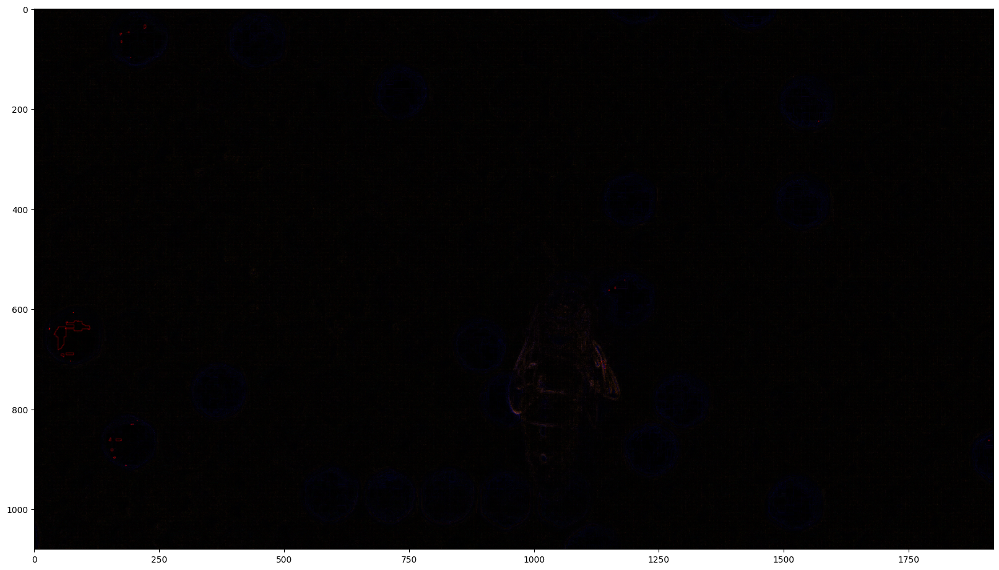

In [270]:
plt.figure(figsize=(20,20))
plt.imshow(log_claheMean, cmap='gray')

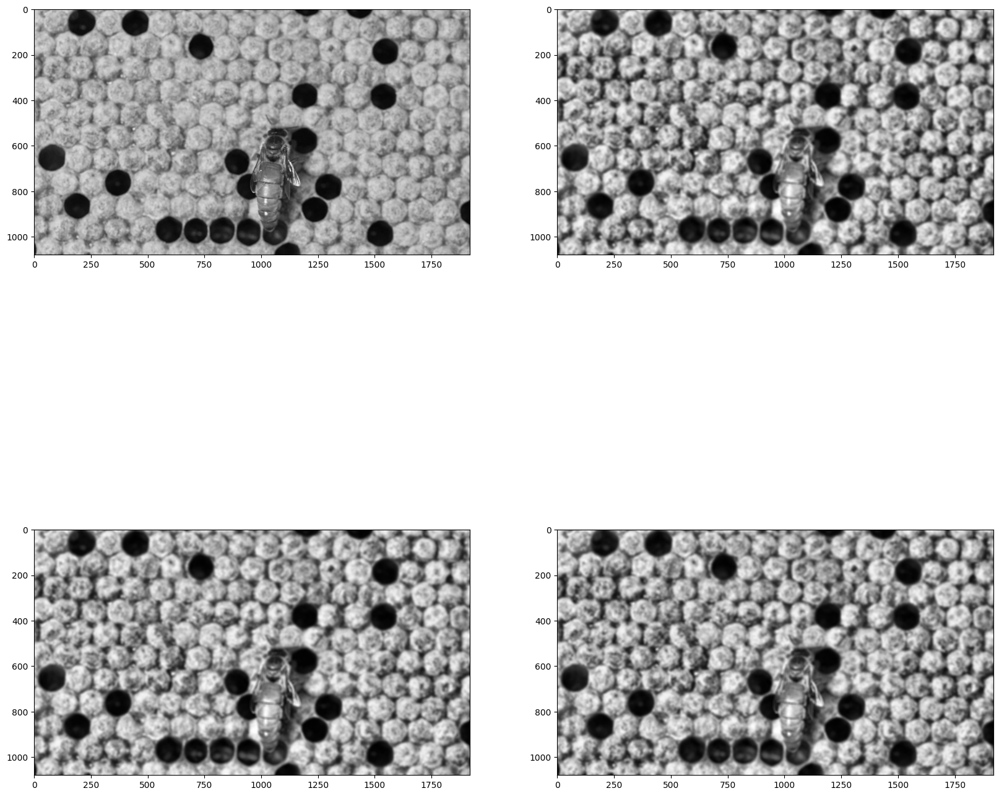

In [134]:
import cv2



# 가우시안 필터 적용
kernel_size = (11, 11)  # 커널 크기를 지정합니다. (홀수 값이어야 합니다.)
sigma = 30.0  # 가우시안 분포의 표준 편차를 지정합니다.


# 결과 이미지를 표시

original_img_gray = cv2.cvtColor(original_img, cv2.COLOR_RGB2GRAY)
original_img_LAB = cv2.cvtColor(original_img, cv2.COLOR_RGB2LAB)
original_img_YCrCb = cv2.cvtColor(original_img, cv2.COLOR_RGB2YCrCb)

blurreTest = cv2.GaussianBlur(claheTest, kernel_size, sigma)
blurreTestLAB = cv2.GaussianBlur(claheTestLAB, kernel_size, sigma)
blurreTestYCrCb = cv2.GaussianBlur(claheTestYCrCb, kernel_size, sigma)

plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(original_img_gray, cmap="gray")

plt.subplot(222)
plt.imshow(blurreTest, cmap="gray")

plt.subplot(223)
plt.imshow(blurreTestLAB, cmap="gray")

plt.subplot(224)
plt.imshow(blurreTestYCrCb, cmap="gray")


In [ ]:
import cv2



# 가우시안 필터 적용
kernel_size = (11, 11)  # 커널 크기를 지정합니다. (홀수 값이어야 합니다.)
sigma = 30.0  # 가우시안 분포의 표준 편차를 지정합니다.


# 결과 이미지를 표시

original_img_gray = cv2.cvtColor(original_img, cv2.COLOR_RGB2GRAY)
original_img_LAB = cv2.cvtColor(original_img, cv2.COLOR_RGB2LAB)
original_img_YCrCb = cv2.cvtColor(original_img, cv2.COLOR_RGB2YCrCb)

blurreTest = cv2.GaussianBlur(claheTest, kernel_size, sigma)
blurreTestLAB = cv2.GaussianBlur(claheTestLAB, kernel_size, sigma)
blurreTestYCrCb = cv2.GaussianBlur(claheTestYCrCb, kernel_size, sigma)

plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(original_img_gray, cmap="gray")

plt.subplot(222)
plt.imshow(blurreTest, cmap="gray")

plt.subplot(223)
plt.imshow(blurreTestLAB, cmap="gray")

plt.subplot(224)
plt.imshow(blurreTestYCrCb, cmap="gray")


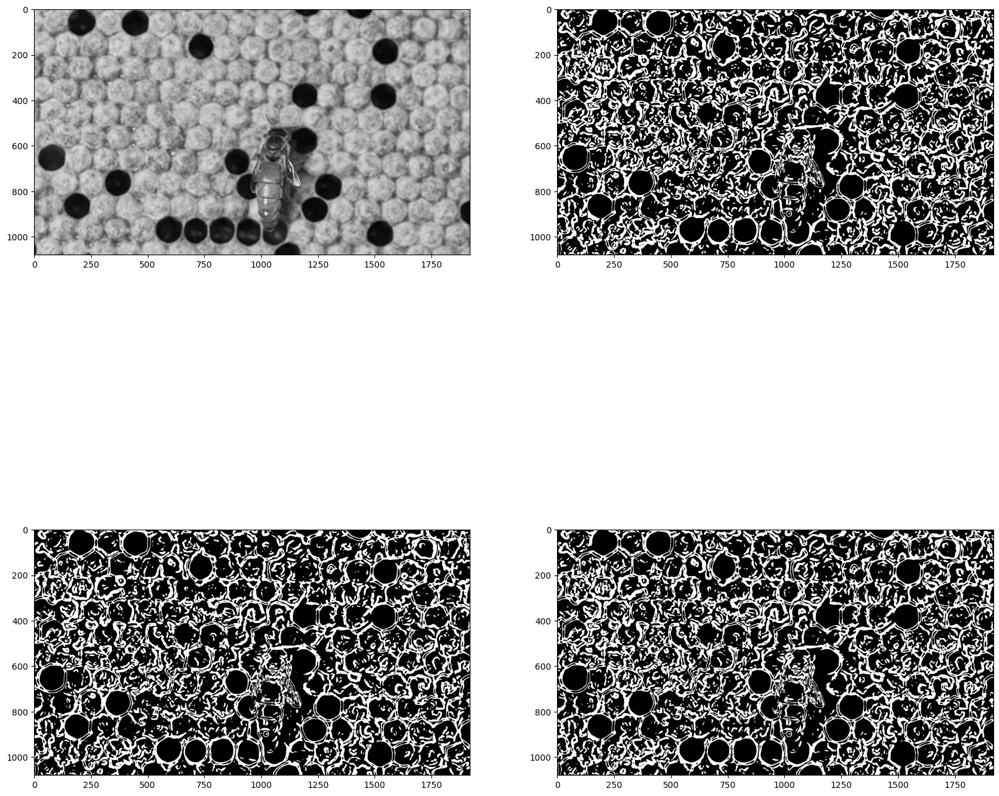

In [156]:
# 이미지 불러오기

original_img_gray = cv2.cvtColor(original_img, cv2.COLOR_RGB2GRAY)
original_img_LAB = cv2.cvtColor(original_img, cv2.COLOR_RGB2LAB)
original_img_YCrCb = cv2.cvtColor(original_img, cv2.COLOR_RGB2YCrCb)

# Sobel 필터를 적용하여 엣지 검출
blurreEdgeTest = apply_sobel_edge_detection(blurreTest)
blurreEdgeTestLAB = apply_sobel_edge_detection(blurreTestLAB)
blurreEdgeTestYCrCb = apply_sobel_edge_detection(blurreTestYCrCb)


# 결과 이미지를 표시


plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(original_img_gray, cmap="gray")

plt.subplot(222)
plt.imshow(blurreEdgeTest, cmap="gray")

plt.subplot(223)
plt.imshow(blurreEdgeTestLAB, cmap="gray")

plt.subplot(224)
plt.imshow(blurreEdgeTestYCrCb, cmap="gray")

In [154]:
import cv2
import numpy as np

def apply_sobel_edge_detection(image, threshold1=40, threshold2=90):
    # 그레이스케일 이미지로 변환

    # Sobel 필터를 적용하여 엣지 검출
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

    # 엣지 강도 및 방향 계산
    gradient_magnitude = np.sqrt(sobel_x**2 + sobel_y**2)
    gradient_direction = np.arctan2(sobel_y, sobel_x)

    # 엣지 감지 결과에 임계값 적용
    edge_image = np.zeros_like(gradient_magnitude)
    edge_image[(gradient_magnitude >= threshold1) & (gradient_magnitude <= threshold2)] = 255

    return edge_image

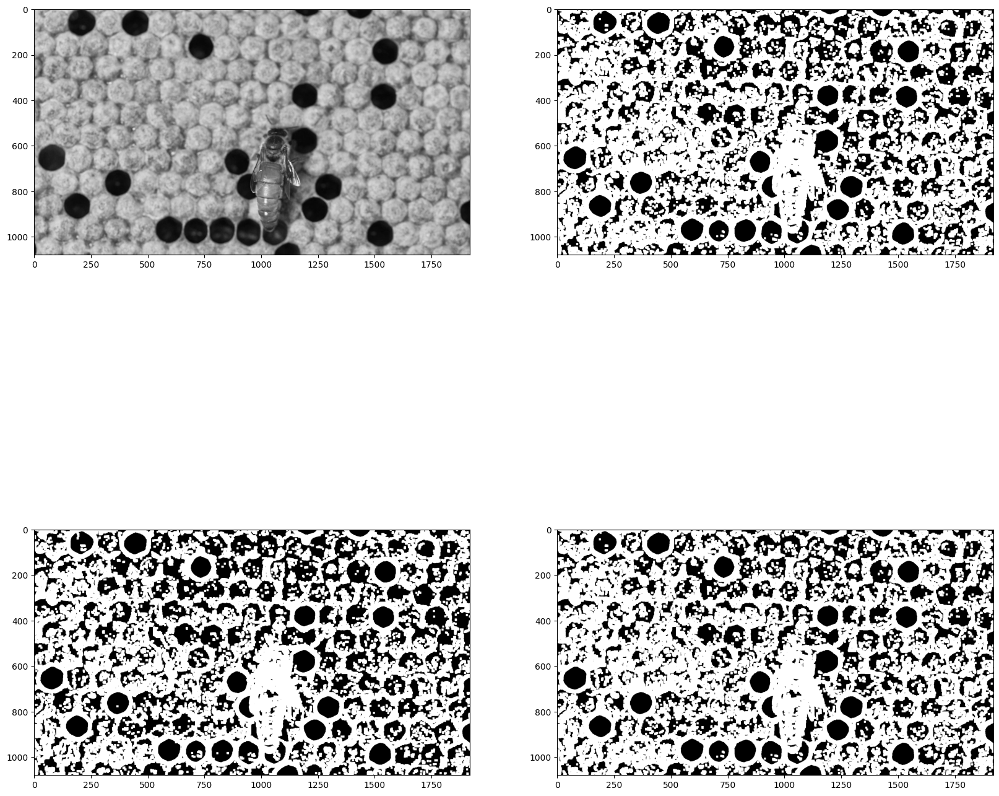

In [148]:
# 구조 요소 (커널) 정의
kernel_size = (9, 9)  # 구조 요소의 크기를 지정합니다. (홀수값이어야 합니다.)
kernel = np.ones(kernel_size, np.uint8)  # 모든 값이 1인 구조 요소를 생성합니다.


# 팽창 연산 수행
dilateTest = cv2.morphologyEx(edgeTest, cv2.MORPH_DILATE, kernel)
dilateTestLAB = cv2.morphologyEx(edgeTestLAB, cv2.MORPH_DILATE, kernel)
dilateTestYCrCb = cv2.morphologyEx(edgeTestYCrCb, cv2.MORPH_DILATE, kernel)


# 결과 이미지를 표시


plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(original_img_gray, cmap="gray")

plt.subplot(222)
plt.imshow(dilateTest, cmap="gray")

plt.subplot(223)
plt.imshow(dilateTestLAB, cmap="gray")

plt.subplot(224)
plt.imshow(dilateTestYCrCb, cmap="gray")


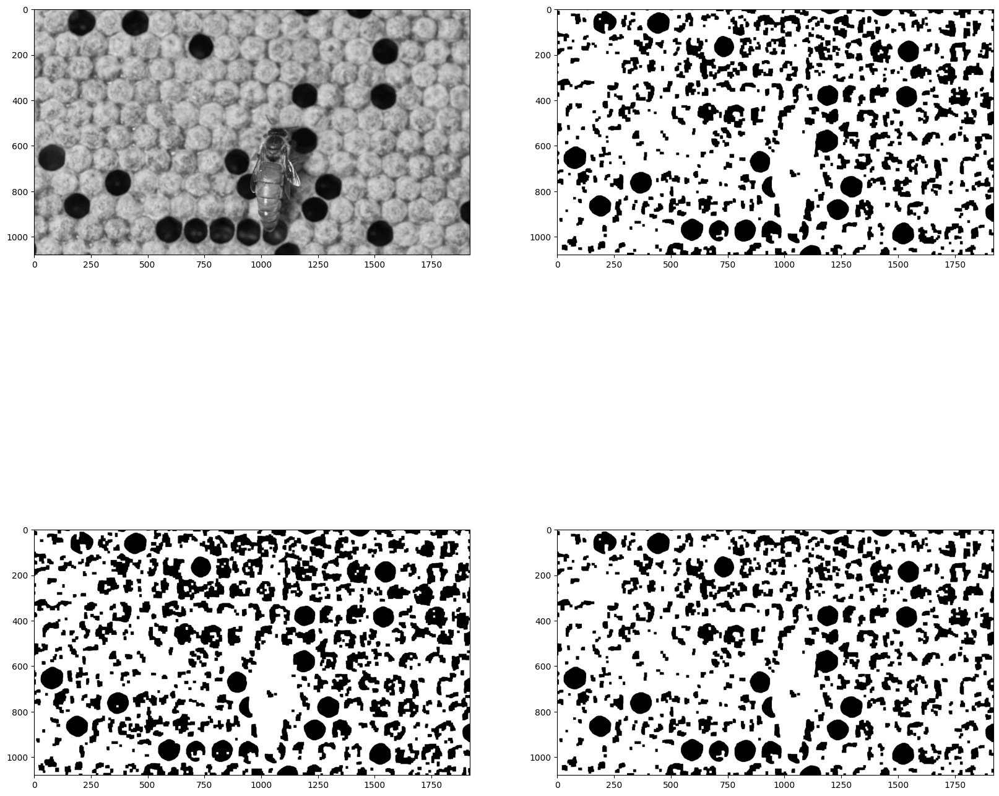

In [149]:
# 구조 요소 (커널) 정의
kernel_size = (11, 11)  # 구조 요소의 크기를 지정합니다. (홀수값이어야 합니다.)
kernel = np.ones(kernel_size, np.uint8)  # 모든 값이 1인 구조 요소를 생성합니다.


# 팽창 이미지 침식 연산 수행
closeTest = cv2.morphologyEx(dilateTest, cv2.MORPH_CLOSE, kernel)
closeTestLAB = cv2.morphologyEx(dilateTestLAB, cv2.MORPH_CLOSE, kernel)
closeTestYCrCb = cv2.morphologyEx(dilateTestYCrCb, cv2.MORPH_CLOSE, kernel)


# 결과 이미지를 표시


plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(original_img_gray, cmap="gray")

plt.subplot(222)
plt.imshow(closeTest, cmap="gray")

plt.subplot(223)
plt.imshow(closeTestLAB, cmap="gray")

plt.subplot(224)
plt.imshow(closeTestYCrCb, cmap="gray")


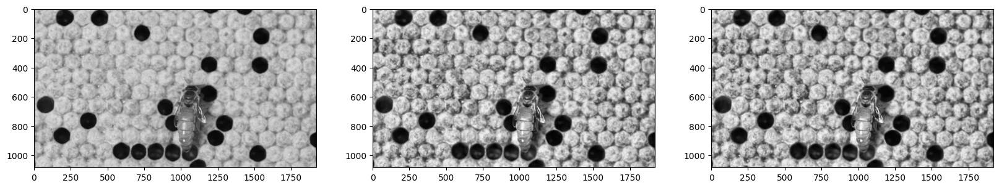

In [114]:
import cv2
import matplotlib.pyplot as plt

original_img_gray = cv2.cvtColor(original_img, cv2.COLOR_RGB2GRAY)
original_img_LAB = cv2.cvtColor(original_img, cv2.COLOR_RGB2LAB)

claheTest = apply_clahe(original_img_gray)
claheTestLAB = apply_clahe(original_img_LAB[:,:,0])
claheTestLABMul= original_img[:,:,0]*claheTestLAB

plt.figure(figsize=(20,20))

plt.subplot(131)
plt.imshow(original_img_gray, cmap="gray")

plt.subplot(132)
plt.imshow(claheTestLAB, cmap="gray")

plt.subplot(133)
plt.imshow(claheTestLABMul, cmap="gray")